### <center>Поиск Аномалий в Данных</center>

### Зачем Вообще Искать Аномалии?
- Предобработка данных: убираем выбросы, чтобы не переобучиться
- Анализ выбросов: хотим найти, понять и обезвредить
- Поиск аномалий как самоцель

**Поиск аномалий** может быть как конечной целью анализа и построения моделей, так и промежуточным этапом подготовки и очистки данных. В первом сценарии мы хотим научиться для каждого объекта выборки выносить вердикт, является ли он аномальным/нестандартным, а во-втором мы находим и убираем выбросы в данных, чтобы в дальнейшем получить более устойчивые модели. 

В [определении](https://scikit-learn.org/stable/modules/outlier_detection.html) из документации scikit-learn, здача поиска аномалий разделяется на два возможных типа:

- **Outlier detection** (поиск выбросов): в тренировочной выборке содержатся выбросы, которые определяются как наблюдения, лежащие далеко от остальных. Таким образом, алгоритмы для детектирования выбросов пытаются найти регионы, где сосредоточена основная масса тренировочных данных, игрорируя аномальные наблюдения.
- **Novelty detection** (поиск "новизны"): тренировочная выборка не загрязнена выбросами, и мы хотим научиться отвечать на вопрос "является ли новое наблюдение выбросом". 



### Сложности при Поиске Аномалий

На практике задача поиска аномалий зачастую не сводится к построению бинарного классификатора "выброс/не выброс". Реальные данные редко бывают размечены и мы вынуждены использовать методы обучения без учителя. 

Одновременно с этим возникает вопрос о построении надежной схемы валидации, ведь если "правильных ответов" у нас нет, то и понять, насколько алгоритм справляется со своей задачей, уже сложнее. Здесь очень помогут экспертные оценки о проценте аномальных объектов, которые ожидаются в выборке, так как с ними можно будет сравнивать прогнозные значения и варьировать тем самым чувствительность алгоритмов. 

Если же поиск и очистка от аномалий - это шаг в подготовке данных для последующего моделирования, то можно использовать стандартные подходы: разбиение на train/test, кросс-валидацию и т.д. Конечно, чтобы избежать переобучения, **очистка в этом случае должна проводиться только на тренировочной части датасета.**

### Методы
Для обнаружения аномалий можно использвовать **supervised или unsupervised методы ML**

### Supervised
Предполагается, что анамалии уже размечены и необходимо обучить алгоритмы классификации аномалий. На практике встречается редко, т.к. данных обычно очень много, разметки нет или очень дорого/долго размечать.

### Unsupervised
Самый распространенный подход при котором мы не имеем разметки и алгоритмы необходимо самому определить аномалии. То насколько хорошо качетво, можно определить используя:
- Экспертные оценки (предоставить результаты, а эксперты оценят насколько хороши результаты)
- Визуально: гистограммы, распределения, скаттерплоты или боксплоты

**Основные Методы**
- Вероятностные: Правило сигм
- Статистики: Отклонение от среднего, Перцентили, Квантили
- Статистические Тесты


**Посложнее:**
- **Distance-Based**: Находим центроиды/средние/кластеры "хороших" наблюдений и считаем расстояние до них, если расстояние больше некоторого порогового значения - аномалия 
- **Density-Based**: Похожее, но по вероятностям/плотностям, если плотность ниже порога - аномалия (DBSCAN)
- **Model-Based**: Строим модельки, а они уже разберутся
    - *Линейные методы:* Пытаемся построить некоторую линейную разделяющую гиперплоскость между "хорошими" и "аномальными значениями" (One-Class SVM http://rvlasveld.github.io/blog/2013/07/12/introduction-to-one-class-support-vector-machines/)
    - *Деревянные методы*: Строим решающее дерево, чтобы понять, сколько раз пришлось делить выборку, чтобы добраться до конкретной точки (Isolation Forest https://quantdare.com/isolation-forest-algorithm/)
    - *Deep-Learning*: Cтроим сжатую репрезентацию наших данных, наблюдения с самой большой ошибкой восстановления (representation error) (autoencoders https://deeplearning4j.org/tutorials/05-basic-autoencoder-anomaly-detection-using-reconstruction-error) 

In [1]:
import pandas as pd
import numpy as np 

import matplotlib.pyplot as plt
import seaborn as sns 
import warnings 

warnings.filterwarnings("ignore")

In [2]:
cd D:\GIT_REPOES\ML_DL_Scripts\Time_Series\data

D:\GIT_REPOES\ML_DL_Scripts\Time_Series\data


In [3]:
data = pd.read_csv('winequality-white.csv', sep=';')
data.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6


### Exploratory Data Analysis 


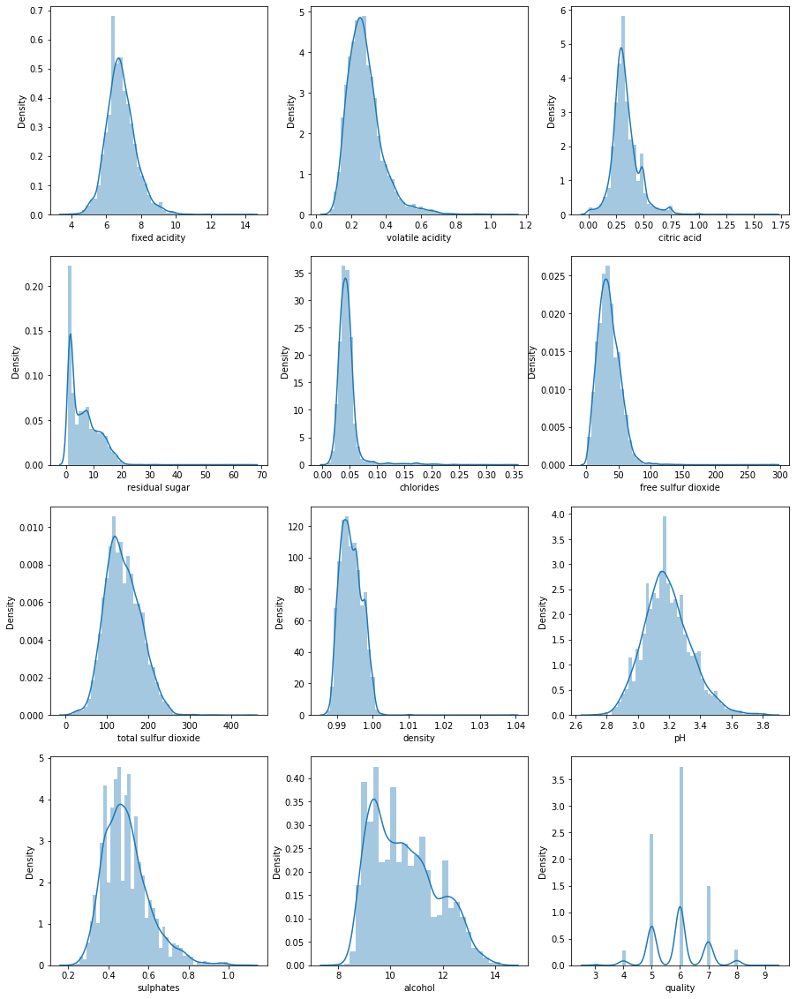

In [4]:
def plot_kde_plots(data, figsize, n_rows, n_cols):
    """
    Plots KDE plots for a given dataset using Seaborn
    Note: Features must be continuous!

    """
    fig, axes = plt.subplots(n_rows, n_cols, figsize=figsize)
    for indx, feature in enumerate(data.columns):
        sns.distplot(data[feature].dropna(), ax=axes[indx // n_cols, indx % n_cols])
        
plot_kde_plots(data, figsize=(15, 20), n_rows=4, n_cols=3)

Можем заметить, что имеем признаки с тяжелыми правыми хвостами. Распределения таких признаков сильно смещены влево. 

В хвостах таких распределенйи и сосредоточены аномальные значения. Среди таких:
- `fixed acidity`
- `volatile acidity`
- `citric acid`
- `residual sugar`
- `chlorides`
- `free sulfur dioxide`
- `density`

Также проверим скоррелированность признаков между собой 

In [5]:
def make_btf_heatmap(df_corrs, title=None):
    fig, ax = plt.subplots(figsize=(12, 10))
    mask = np.triu(np.ones_like(df_corrs, dtype=np.bool))
    mask = mask[1:, :-1]
    corr = df_corrs.iloc[1:,:-1].copy()
    cmap = sns.diverging_palette(0, 230, 90, 60, as_cmap=True)
    sns.heatmap(corr,
                mask=mask, 
                annot=True,
                fmt=".2f",
                linewidths=5,
                cmap=cmap,
                vmin=-1,
                vmax=1, 
                cbar_kws={"shrink": .8},
                square=True)
    
    yticks = [i.upper() for i in corr.index]
    xticks = [i.upper() for i in corr.columns]
    plt.yticks(plt.yticks()[0], labels=yticks, rotation=0)
    plt.xticks(plt.xticks()[0], labels=xticks)
    plt.title(title, loc='left', fontsize=18)
    plt.show()

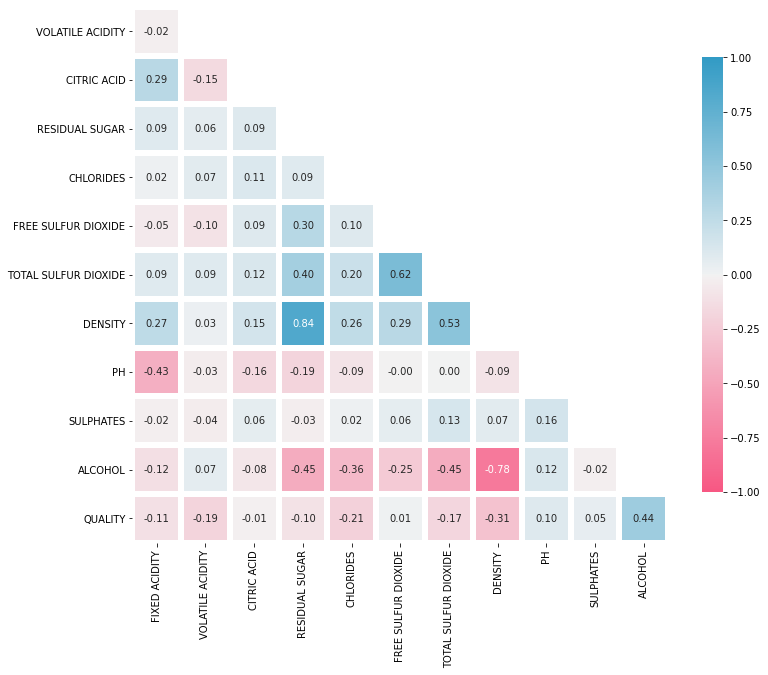

In [6]:
make_btf_heatmap(data.corr())

Топ самых скоррелированных признаков:
- `density-residual_sugar`
- `alcohol-density`

In [7]:
# Отберем скоррелированные признаки 
def select_corr_features(df_corrs, thresh):
    corr_matrix = df_corrs.where(np.tril(np.ones(df_corrs.shape), k=-1).astype(bool))
    highly_corr_feat = [
        column for column in corr_matrix.columns if any((corr_matrix[column] >= thresh) | (corr_matrix[column] <= -thresh))
    ]
    return highly_corr_feat

highly_corr_feat = select_corr_features(data.corr(), thresh=0.6)
highly_corr_feat

['residual sugar', 'free sulfur dioxide', 'density']

Взглянем на диаграмму рассеяния для скоррелированных признаков 

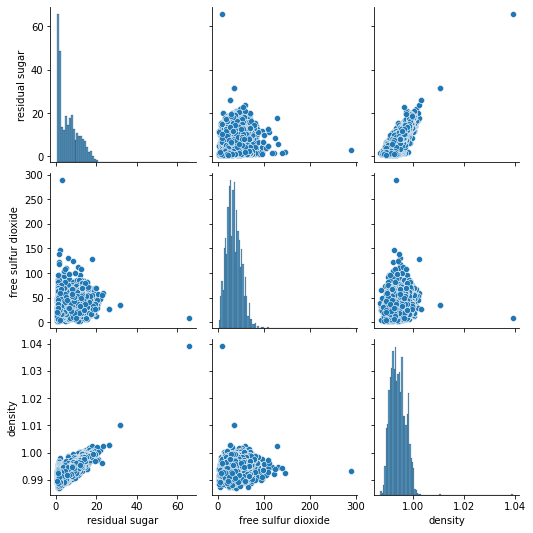

In [8]:
sns.pairplot(data[highly_corr_feat]);

Аномалии также отчетливо видно (точки, удаленные от основной массы точек)

Теперь посмотрим на признаки, которые не скоррелированы

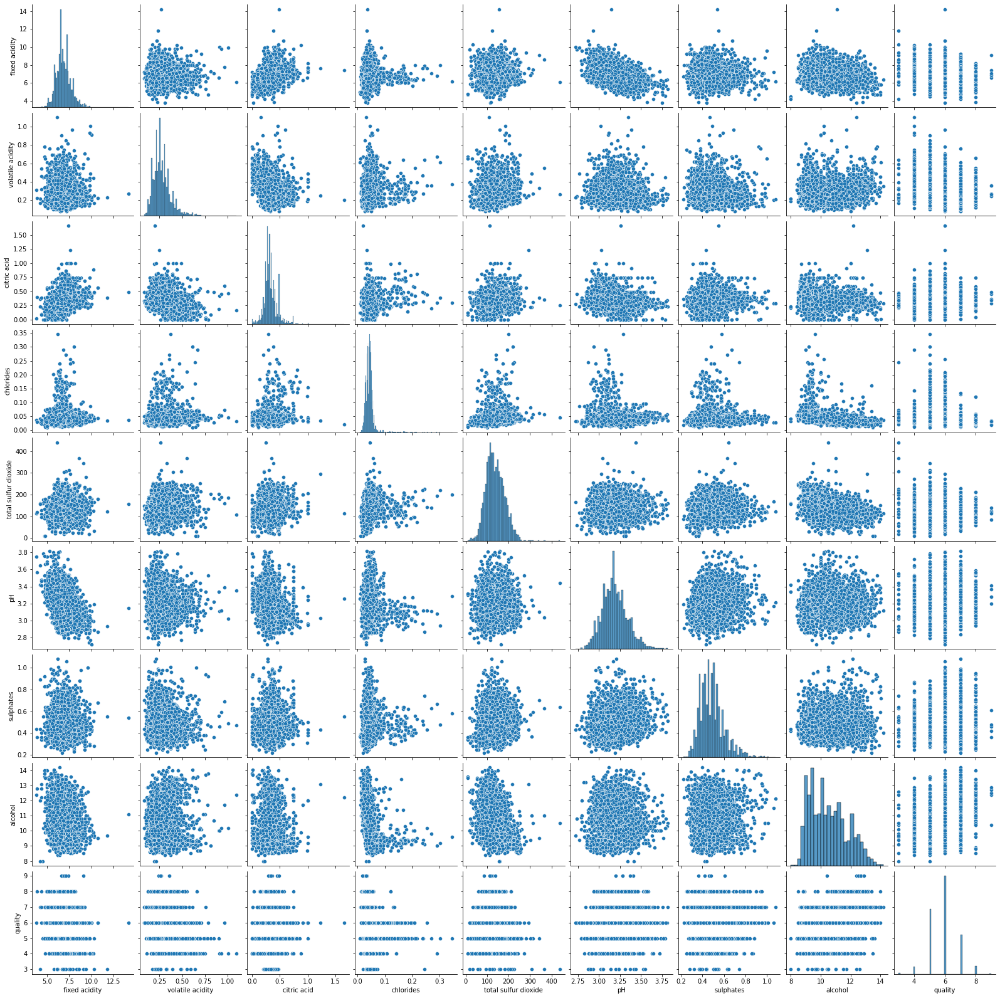

In [9]:
# Нескорелированные признаки (далее будет рассматривать только их)
other_features = data[data.columns[~data.columns.isin(highly_corr_feat)]].columns
main_df = data[other_features]

sns.pairplot(main_df);

Аномалии также могут быть легко обнаружены 

### Правило 2/3-х сигм 
Используем информацию только по одному признаку и **не учитываем взаимодействие признаков** (смотри `pairplot`)

Основным недостатком данного метода является **среднее**, если наши признаки очень шумные (много выбросов), то мы получим смещенную оценку среднего, следовательно, мы ложно примем часть наблюдений за выбросы. 

Для более устойчивой оценки, можно применить межквартильное расстояние (IRQ) (т.к. мы**используем кваньтили распределений**)

In [10]:
def is_anomaly_sigma_rule(data, col, thresh=3):
    """
    Applies sigma rule for a single feature
    
    data: DataFrame
    
    col: str
        Feature name 
    
    thresh: int
        Sigma value
    
    Returns: Series
        Boolean Series mask of outliers
        
    """
    feature_mean = data[col].mean()
    feature_std = data[col].std()
    upper_bound = feature_mean + thresh * feature_std
    lower_bound = feature_mean - thresh * feature_std
    anomalies_mask = pd.concat([data[col] > upper_bound, data[col] < lower_bound], axis=1).any(1)
    
    return anomalies_mask, upper_bound, lower_bound 


def get_feature_anomalies(data, func, features=None, thresh=3):
    if features:
        features_to_check = features
    else:
        features_to_check = data.columns 
        
    outliers = pd.Series(data=[False] * data.shape[0], index=data[features_to_check].index, name='is_outlier')
    anomalies_summary = {}
    for feature in features_to_check:
        anomalies_mask, upper_bound, lower_bound = func(data, feature, thresh=thresh)
        anomalies_summary[feature] = [upper_bound, lower_bound, sum(anomalies_mask), 100*sum(anomalies_mask)/len(anomalies_mask)]
        outliers[anomalies_mask[anomalies_mask].index] = True
        
    anomalies_summary = pd.DataFrame(anomalies_summary).T
    anomalies_summary.columns=['upper_bound', 'lower_bound', 'anomalies_count', 'anomalies_percentage']
    
    anomalies_ration = round(anomalies_summary['anomalies_percentage'].sum(), 2)
    print(f'Total Outliers Ration: {anomalies_ration} %')
    
    return anomalies_summary, outliers 

In [11]:
anomalies_summary_sigma, is_outlier_sigma = get_feature_anomalies(main_df, func=is_anomaly_sigma_rule, thresh=3)
anomalies_summary_sigma

Total Outliers Ration: 8.8 %


,upper_bound,lower_bound,anomalies_count,anomalies_percentage
fixed acidity,9.386392,4.323183,46.0,0.939159
volatile acidity,0.580625,-0.024143,81.0,1.653736
citric acid,0.697251,-0.028868,85.0,1.735402
chlorides,0.111316,-0.019772,102.0,2.082483
total sulfur dioxide,265.854851,10.866464,12.0,0.244998
pH,3.641268,2.735265,32.0,0.653328
sulphates,0.832224,0.147469,48.0,0.979992
alcohol,14.206129,6.822405,0.0,0.000000
quality,8.534825,3.220994,25.0,0.510412


Можем легко выделить признаки с большим числом аномалий, например:
- `volatile acidity`
- `citric acid`
- `chlorides`

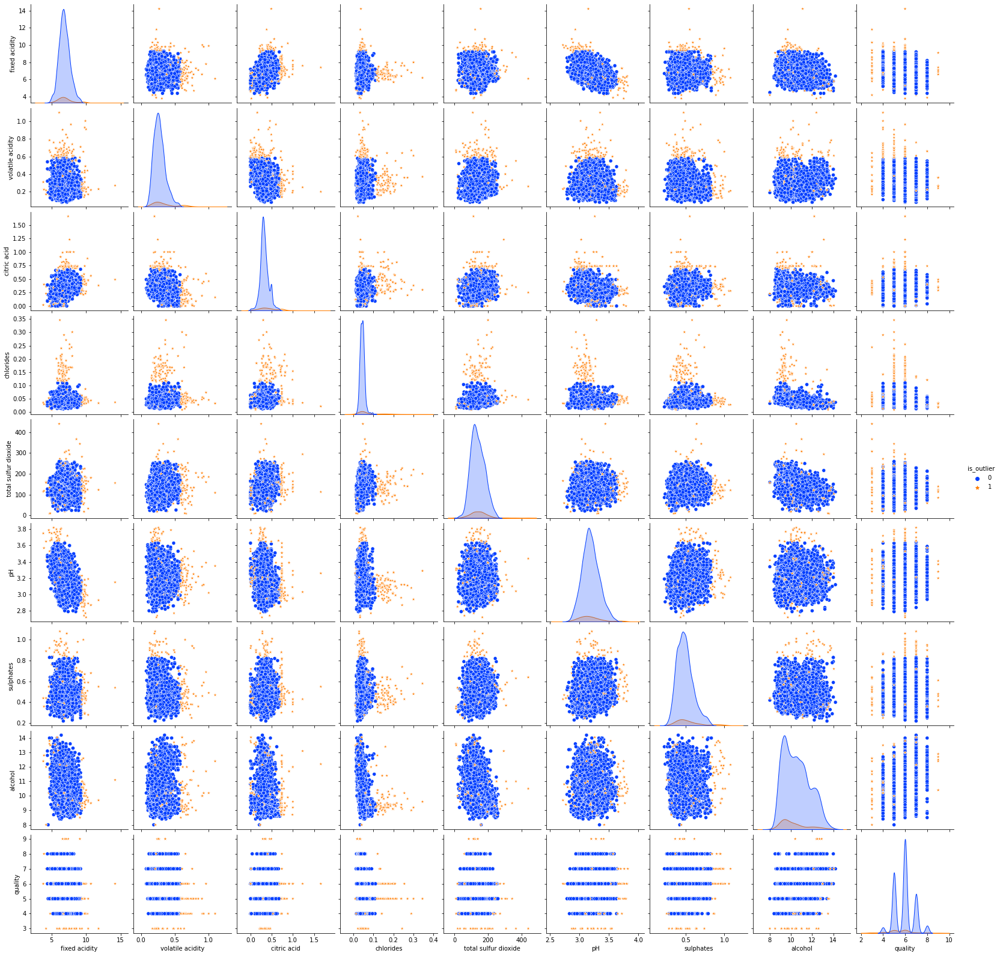

In [26]:
outlier_df_sigma = main_df.copy()
outlier_df_sigma['is_outlier'] = is_outlier_sigma

sns.pairplot(data=outlier_df_sigma, hue='is_outlier', hue_order=[0, 1], markers=['o', '*'], palette='bright');

### Межквартильное Расстояние 

In [13]:
def is_anomaly_irq(data, col, thresh):
    """
    Finds outliers/anomalies using IRQ 
    
    data: DataFrame
    col: str
    thresh: int
        Count of IRQ to apply 
    
    Returns: Sereis 
        Boolean Series Mask of outliers 

    """
    IRQ = data[col].quantile(0.75) - data[col].quantile(0.25)
    upper_bound = data[col].quantile(0.75) + (thresh * IRQ)
    lower_bound = data[col].quantile(0.25) - (thresh * IRQ)
    anomalies_mask = pd.concat([data[col] > upper_bound, data[col] < lower_bound], axis=1).any(1)
    
    return anomalies_mask, upper_bound, lower_bound

In [14]:
anomalies_summary_irq, is_outlier_irq = get_feature_anomalies(main_df, func=is_anomaly_irq, thresh=3)
anomalies_summary_irq

Total Outliers Ration: 4.27 %


,upper_bound,lower_bound,anomalies_count,anomalies_percentage
fixed acidity,10.300,3.300,4.0,0.081666
volatile acidity,0.650,-0.120,39.0,0.796243
citric acid,0.750,-0.090,22.0,0.449163
chlorides,0.092,-0.006,131.0,2.674561
total sulfur dioxide,344.000,-69.000,2.0,0.040833
pH,3.850,2.520,0.0,0.000000
sulphates,0.970,-0.010,11.0,0.224581
alcohol,17.100,3.800,0.0,0.000000
quality,9.000,2.000,0.0,0.000000


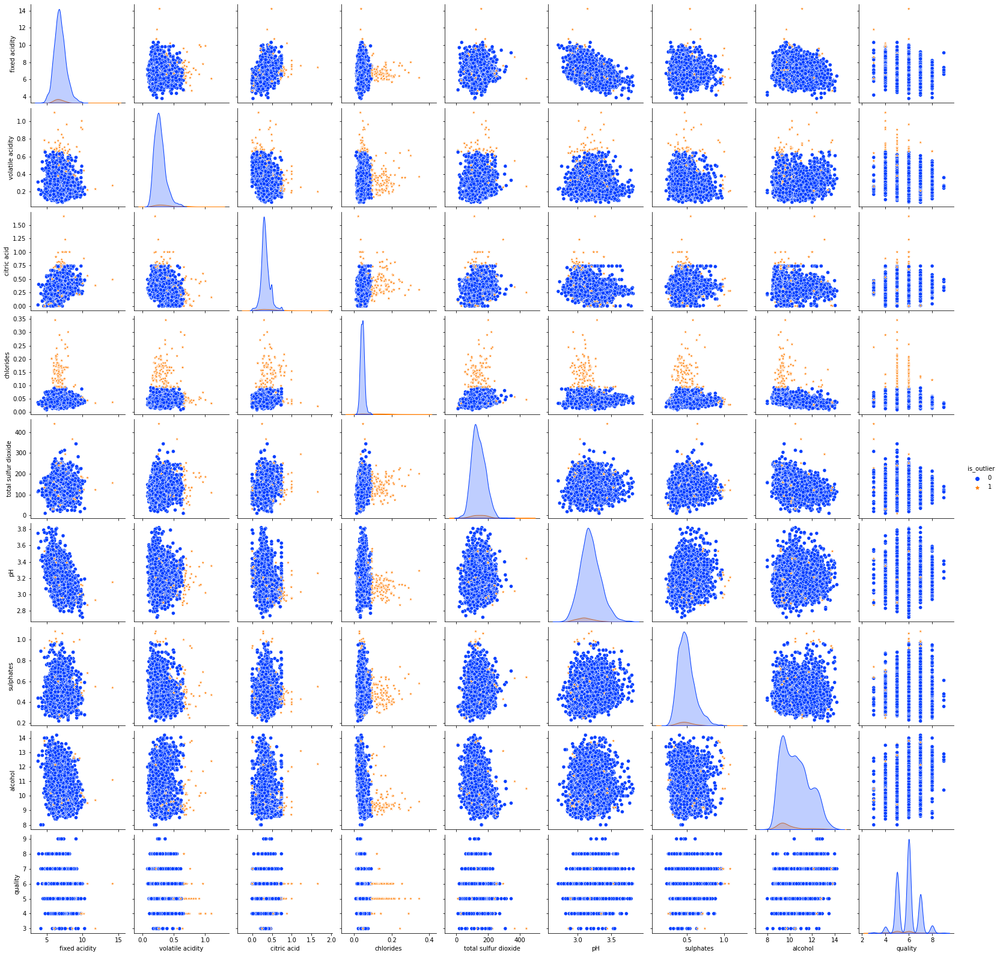

In [115]:
outlier_df_irq = main_df.copy()
outlier_df_irq['is_outlier'] = is_outlier_irq

sns.pairplot(data=outlier_df_irq, hue='is_outlier', hue_order=[0, 1], markers=['o', '*'], palette='bright');

Заметно, что использование межквартильного расстояние приводит к более устойчивой оценке. Границы получаются более плавными и процент выбросов стал заметно ниже (почти в 2 раза меньше).

Признак `chlorides` является очень шумным. На графике выше мы это отчетливо видим (много выбросов как по диагонали так и по вертикали)

**Метод также не учитывает взаимодействие признаков**

Для учитывания взаимодействия признаков можно использовать следующую эвристику. Например, взглянуть на `scatterplot` и определить парог признаков при взаимодействиии с которыми, данное наблюдение было аномальным. Например, если наблюдение является аномальным на 5/10 графиках `scatterplot`, то это аномалия.

### Кластеризация

### Центроид Кластера
Осуществим группировку наших наблюдений в пространстве признаков и определим центроид (среднее по всем признакам)

Далее, определим расстояние от наблюдений (векторов) до центроида.

Точки, которые сильно будут удалены от цетроида (значения, выходящие за перцентиль) классифицируем как аномалии (расстояние - парог который необходимо будет подобрать)

**Ключевые Параметры:**
- Метрика Расстояния (Евклидово, Манхетенское, Чебышева или др.)
- Перцентиль (Доля исключаемых объектов)



In [16]:
from sklearn.base import BaseEstimator
from scipy.spatial.distance import cdist
from sklearn.preprocessing import RobustScaler

class DistanceOutliers(BaseEstimator):
    """
    Distance based outlier detector model
    
    Fit method calculates centroid of training samples and
    using `metric` get distances from centroid to train samples.
    Having distances - we calculate `threshold` based on `percentile`.
    
    Predict method uses `threshold` and `metric` to determine, whether
    distance to sample from centroid is too large -> outlier.
    
    -----------
    Parameters:
    
    - metric: string, default - euclidean
        metric to use for distance calculation (see scipy.spatial.distance.cdist)
        
    - percentile: float in range [0, 100]
        hyperparameter which sets the threshold for anomalies
    """
    def __init__(self, metric='euclidean', percentile=90):
        self.metric = metric
        self.percentile = percentile
        
    def fit(self, X):
        self.centroid = np.mean(X, axis=0).values.reshape(-1, 1).T
        distances_train = cdist(self.centroid, X, metric=self.metric).reshape(-1)
        self.threshold = np.percentile(distances_train, self.percentile)
        
    def predict(self, X):
        distances = cdist(self.centroid, X, metric=self.metric).reshape(-1)
        predictions = (distances > self.threshold).astype(int)
        return predictions

Прежде всего необходимо отмасштабировать признаки

In [17]:
# Воспользуемся RobustScaler т.к. устойчив к выбросам 
scaler = RobustScaler() 

scaled_data = pd.DataFrame(
    data=scaler.fit_transform(main_df), 
    columns=main_df.columns
)

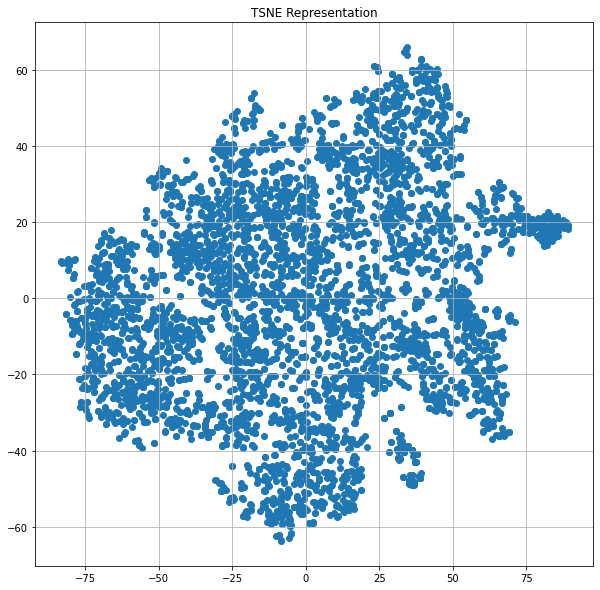

In [28]:
# Взглянем на положение объектов в 2D
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, perplexity=50, n_jobs=-1)
tsne_representation = tsne.fit_transform(scaled_data)

plt.figure(figsize=(10, 10))
plt.scatter(tsne_representation[:, 0], tsne_representation[:, 1])
plt.grid(True)
plt.title('TSNE Representation');

In [19]:
# Определим нашу модель 
euclidean_model = DistanceOutliers(metric='euclidean', percentile=90)
euclidean_model.fit(scaled_data)

euclidean_outliers = euclidean_model.predict(scaled_data)
outliers_ration = round(euclidean_outliers.sum()/euclidean_outliers.shape[0], 2)*100


print(f'Outliers Ration: {outliers_ration} %')

Outliers Ration: 10.0 %


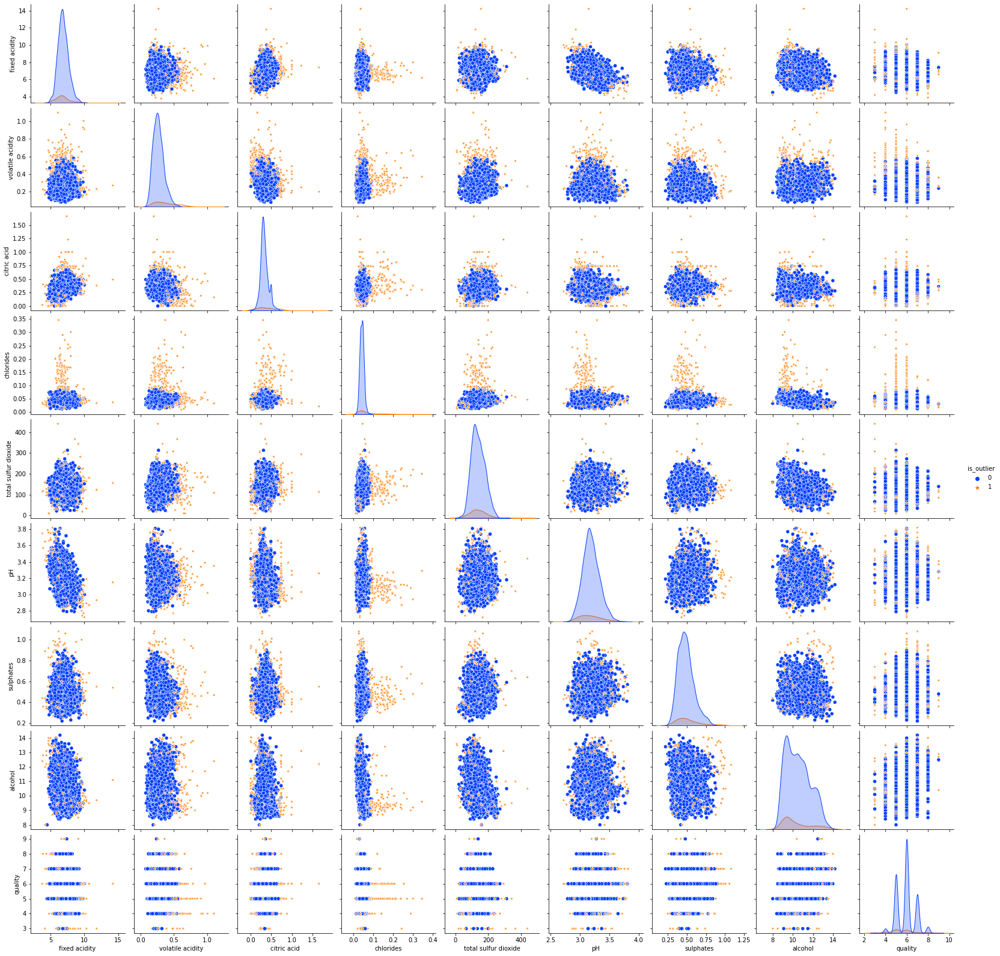

In [116]:
outlier_df_euclidean = main_df.copy()
outlier_df_euclidean['is_outlier'] = euclidean_outliers

sns.pairplot(data=outlier_df_euclidean, hue='is_outlier', hue_order=[0, 1], markers=['o', '*'], palette='bright');

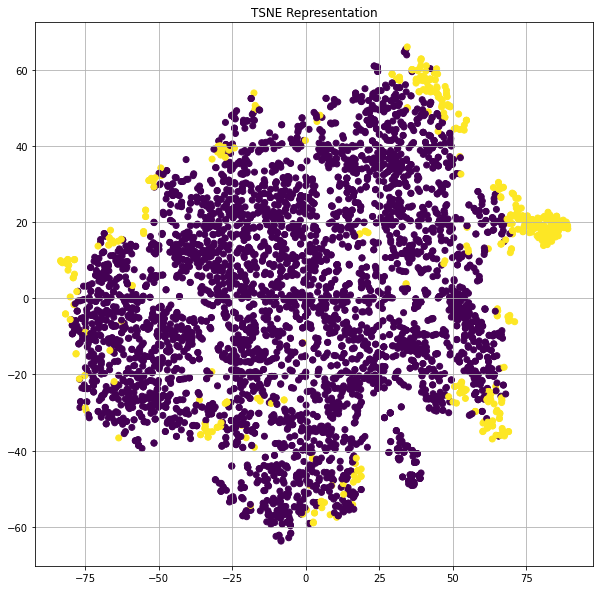

In [118]:
plt.figure(figsize=(10, 10))
plt.scatter(tsne_representation[:, 0], tsne_representation[:, 1], c=euclidean_outliers)
plt.grid(True)
plt.title('TSNE Representation');

Желтым цветом алгоритм определил выбросы. Значения по оси X или Y не являются интерпретируемыми (особенность алгоритма)

Также данный алгоритм учитывает взаимодействие признаков, т.к. мерика считается между векторами объектов.

### Методы Основанные на Плотности (Density Based)

### DBSCAN
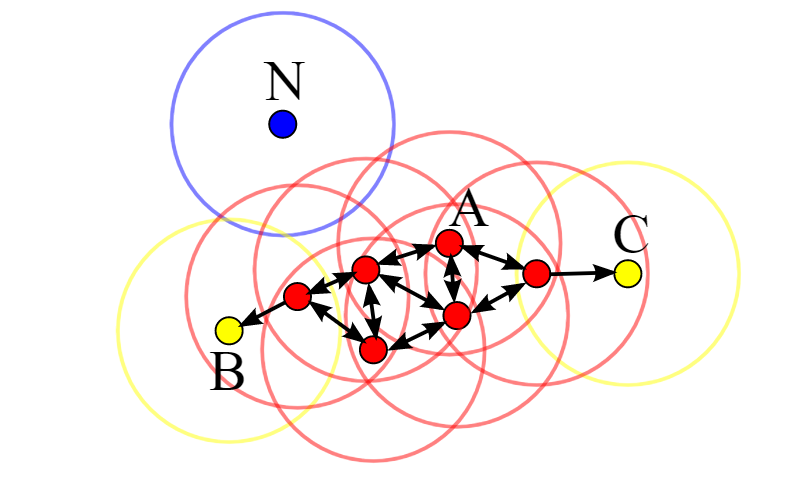
Основные преимущества метода:
- Умеет находить сложные формы кластеров 
- Умеет находить выбросы/аномалии в данных

Основыне недостатки модели:
- Сложно настраивать (Очень чувствительна к параметру `Eps`)

Визуализация работы алгоритма: https://www.naftaliharris.com/blog/visualizing-dbscan-clustering/

**Для поиска оптимального `Eps` можно воспользоваться следующей эвристикой:**

Начнем с очень маленького значения `Eps` и будем итеративно увеличивать его, постпенно снижая долю аномалий (т.к. при очень маленьком `Eps` каждая точка - аномалия)

Затем по парогу аномалий (гиперпараметр), отберем оптимальный `Eps`

In [110]:
from sklearn.cluster import DBSCAN

def find_optimal_eps(scaled_data, init_eps=0.05, eps_inc=0.05, outliers_thresh=0.1):
    """
    Finds optimal Eps parameter for DBSCAN algorithm that provides certain outliers ration 
    
    scaled_data: DataFrame
        Scaled data
    
    init_eps: int
        Initial Eps value
        
    eps_inc: int
        Eps increment for each new iteration 
        
    outliers_thresh: float
        Outliers ration that must not be exceeded
        
    Returns: tuple

    """
    
    # Вначале все объекты - выбросы
    anomalies_ratio = 1.0
    
    n_clusters = []
    anomalies_ratio_lst = []
    
    # Начинаем с самого маленткого eps 
    eps = init_eps
    eps_history = [eps]
    
    # Определяем парог аномалий согласно outliers_thresh
    while anomalies_ratio > outliers_thresh:
        model = DBSCAN(eps=eps).fit(scaled_data)
        # Получаем кластера (кластер с label -1 ~ выбросы/аномалии)
        labels = model.labels_ 
        # Считаем число уникльных кластеров (без кластера аномалий) 
        n_clusters.append(len(np.unique(labels))-1) 

        # Считаем текущую долю аномалий 
        is_label_anomaly = np.array([1 if label == -1 else 0 for label in labels])
        anomalies_ratio = sum(is_label_anomaly)/len(is_label_anomaly)
        anomalies_ratio_lst.append(anomalies_ratio)

        # Увеличиваем Eps
        eps += eps_inc
        eps_history.append(eps)
        
    return n_clusters, anomalies_ratio_lst, eps_history


def plot_eps_vs_anomalies_ratio(eps_history, anomalies_ratio_history):
    eps_values = eps_history[:-1]
    
    fig, ax1 = plt.subplots()
    
    # N_Clusters vs Eps
    ax_1_color = 'red'
    ax1.set_xlabel('Epsilon')
    ax1.set_ylabel('Number of Clusters', color=ax_1_color)
    ax1.plot(eps_values, n_clusters, color=ax_1_color)
    ax1.tick_params(axis='y', labelcolor=ax_1_color)

    # Объявляем ещё одну ось на одном графике 
    ax2 = ax1.twinx() 
    
    # Anomalies Ratio vs Eps
    ax2.set_ylabel('Anomalies Ratio')  
    ax2.plot(eps_values, anomalies_ratio_history)

    fig.tight_layout()
    plt.grid(True);
    
def show_number_ratio_anomalies(data):
    anomalies_ratio = round((sum(data)/len(data))*100, 2)
    print(f'N Anomalies: {sum(data)}')
    print(f'Anomalies Ratio: {anomalies_ratio} %')

In [100]:
# Определим оптимальный Eps
n_clusters, anomalies_ratio_lst, eps_history = find_optimal_eps(scaled_data, 
                                                                init_eps=0.05,
                                                                eps_inc=0.02,
                                                                outliers_thresh=0.1)

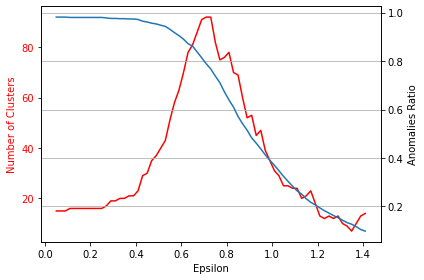

In [101]:
plot_eps_vs_anomalies_ratio(eps_history=eps_history, anomalies_ratio_history=anomalies_ratio_lst)

Можно заметить, что в самом начале значение `Eps` было очень маленьким, а процент аномалий очень большим, почти 100%. 

Число кластеров было также мало. Затем при увеличении `Eps` процент аномалий падает и растёт число кластеров, больший радиус позволяет лучше находить плотные скопления точек

При очень больших значениях `Eps` мы имеем несколько больших и плотных кластеров и малую долю аномалий

In [111]:
# Взглянем на аномалии, используя оптимальное значение Eps
model = DBSCAN(eps_history[-1])
model.fit(scaled_data)
dbscan_outliers = np.array([1 if label == -1 else 0 for label in model.labels_])

show_number_ratio_anomalies(dbscan_outliers)

N Anomalies: 445
Anomalies Ratio: 9.09 %


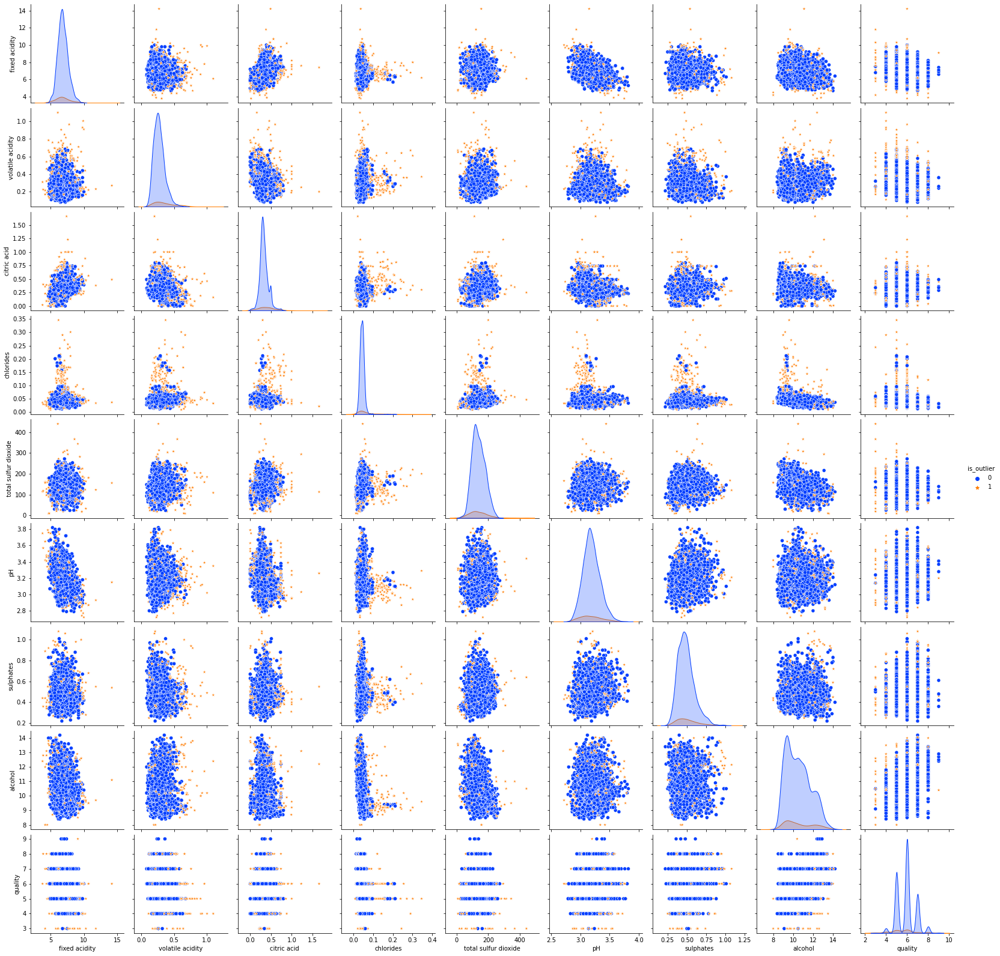

In [117]:
outlier_df_dbscan = main_df.copy()
outlier_df_dbscan['is_outlier'] = dbscan_outliers

sns.pairplot(data=outlier_df_dbscan, hue='is_outlier', hue_order=[0, 1], markers=['o', '*'], palette='bright');

Интересной особенностью является то, что **модель умеет находить нелинейные зависимости в данных.** 

Это можно доказать если посмотреть на график выше. Видно, что объекты которые находятся в области аномалий такими не являются

### Model-Based
Одним из вариантов может служить следующий подход. Взять модель А, например, линейную регрессию и обучить её на кросс-валидации. Затем вычислить ошибку и наблюдения, которые превосходят определенный перцентиль ошибки - исключить. Затем обучить модель B и проверить её на тестовой выборке. **Данный подход работает не всегда и есть высокий риск переобучения.**


### One-Class SVM
One Class SVM - это одна из форм классического алгоритма, однако, как следует из названия, для его обучения нам достаточно иметь всего один класс, пусть даже и немного "зашумленный", при этом мы хотим научиться для каждого нового наблюдения принимать решение, является ли оно аномальным или нет.

Общая идея: преобразовать признаковое пространство и провести разделяющую гиперплоскость так, чтобы наблюдения лежали как можно дальше от начала координат

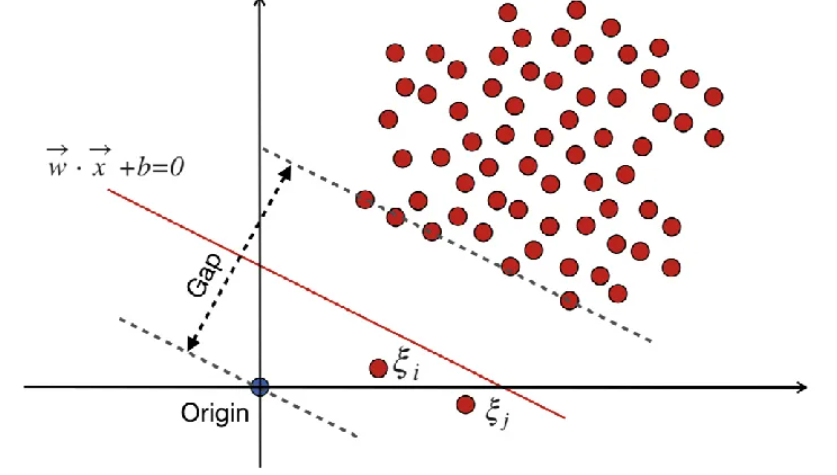

В результате мы получаем границу, по одну сторону которой лежат максимально "плотные" и похожие друг на друга наблюдения из нашей тренировочной выборки, а по другую будут находится аномальные значения, не похожие на все остальные. Процент таких аномальных наблюдений, которые модель будет пытаться отделить от основной части выборки, мы снова задаём в самом начале обучения при помощи параметра `nu`

**К достоинствам метода можно отнести:**
- Kernel Trick (модель способна проводить **нелинейные разделяющие границы**)
- Удобно использовать, когда в данных недостаточно "плохих" наблюдений, чтобы использовать стандартный подход обучения с учителем - бинарную классификацию (читай далее)

**К минусам:**
-  Может очень сильно **переобучиться** и выдавать большое количество ложно отрицательных результатов, если разделяющий зазор слишком мал
- Подбор гиперпараметров (ядро и доля аномалий)

Очень неплохим вариантом использования данного алгоритма является ситуация, когда мы имеем мало размеченных данных. Тогда, мы можем использовать размеченные данные как тестовую выборку и обучить алгоритм на **неразмеченных данных**, чтобы определять аномалии (редкие заболевания, фрод ...) и тестировать его на размеченных данных 

In [121]:
from sklearn.svm import OneClassSVM

one_class_svm = OneClassSVM(nu=0.1, gamma='auto')
one_class_svm.fit(scaled_data)

svm_outliers = one_class_svm.predict(scaled_data)
svm_outliers = np.array([1 if label == -1 else 0 for label in svm_outliers])

show_number_ratio_anomalies(svm_outliers)

N Anomalies: 493
Anomalies Ratio: 10.07 %


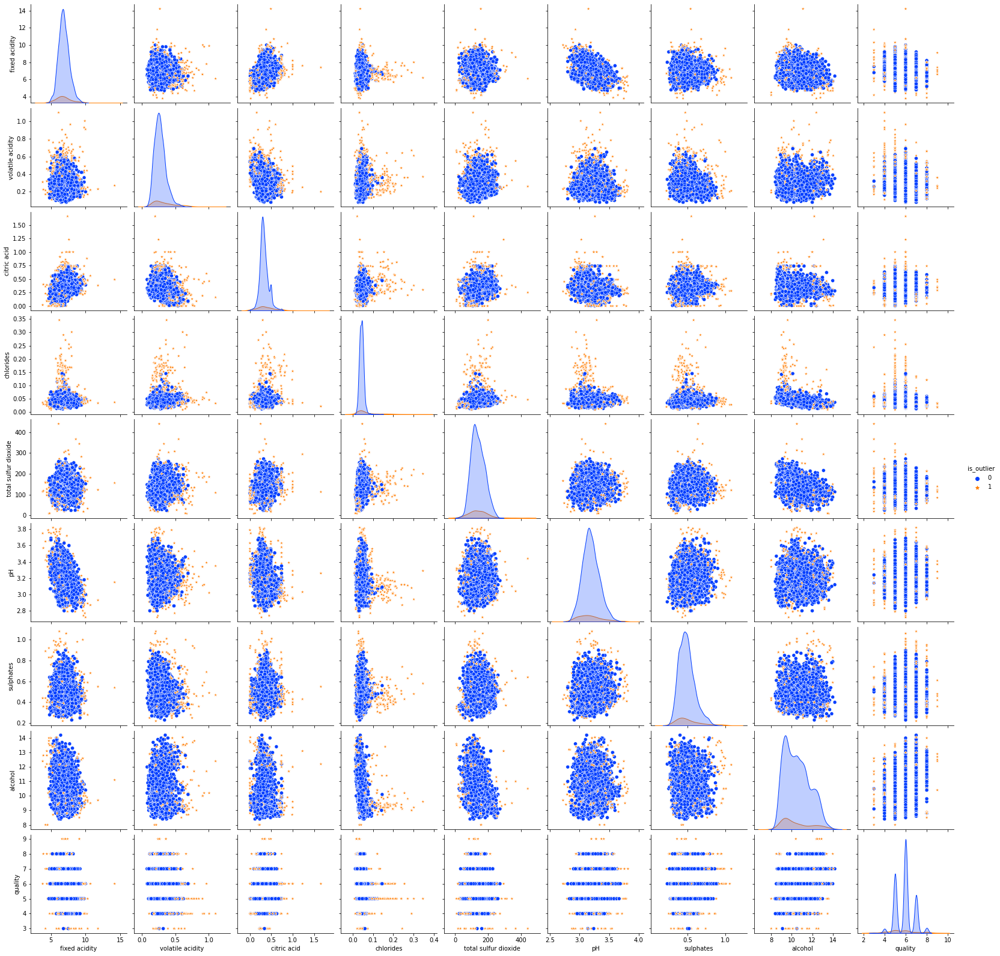

In [122]:
outlier_df_svm = main_df.copy()
outlier_df_svm['is_outlier'] = svm_outliers

sns.pairplot(data=outlier_df_svm, hue='is_outlier', hue_order=[0, 1], markers=['o', '*'], palette='bright');

Получили результаты схожие с `distance-based` методами 


### Isolation Forest
Основная идея - посмотреть, насколько легко можно "изолировать" наблюдения от всех остальных. Если "слишком легко", наверное данное наблюдение лежит далеко и является выбросом. Если "тяжело" - скорее всего похоже на кучу других точек и выбросом не является. 

https://quantdare.com/isolation-forest-algorithm/

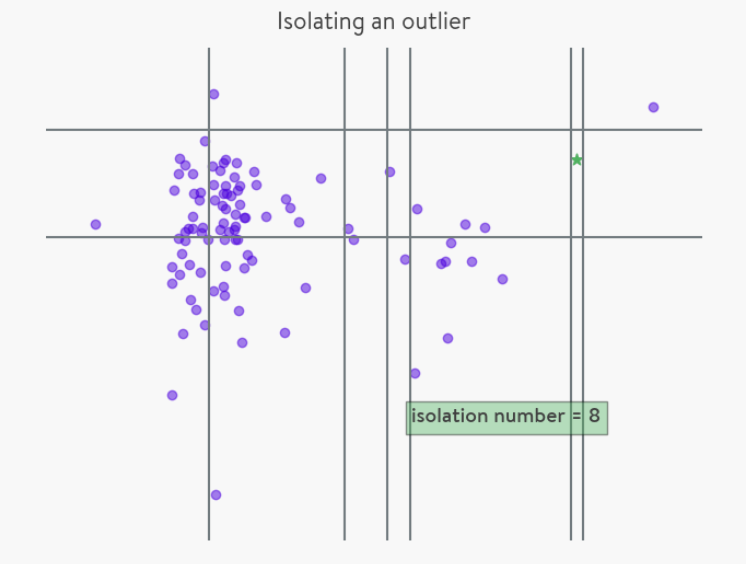

Например, на картинке выше алгоритму понадобилось всего 8 итераций чтобы изолировать наблюдение от всех остальных, т.е. данное наблюдение можно считать выбросом. 

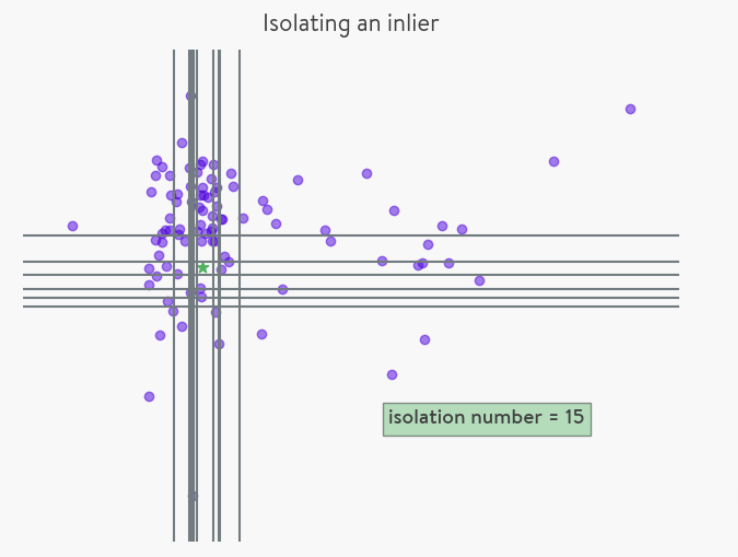
Теперь алгоритму понадобилось уже 15 итераций, что почти в 2 раза больше. Следовательно, данное наблюдение выбросом не является.

Это и так видно на графике (точка находится в основной массе точек)

**Плюсы Алгоритма**
- Интуитивно понятные принципы работы (нелинейные разделяющие границы)

**Минусы**
- Много гиперпараметров которые необходимо настраивать
- Необходимо примерно знать ожидаемую долю аномалий (`contamination`)

In [124]:
from sklearn.ensemble import IsolationForest

isolation_forest = IsolationForest(n_estimators=100, contamination=0.1, 
                                   max_features=1.0, bootstrap=True)
isolation_forest.fit(scaled_data)

isolation_outliers = isolation_forest.predict(scaled_data)
isolation_outliers = np.array([1 if label == -1 else 0 for label in isolation_outliers])

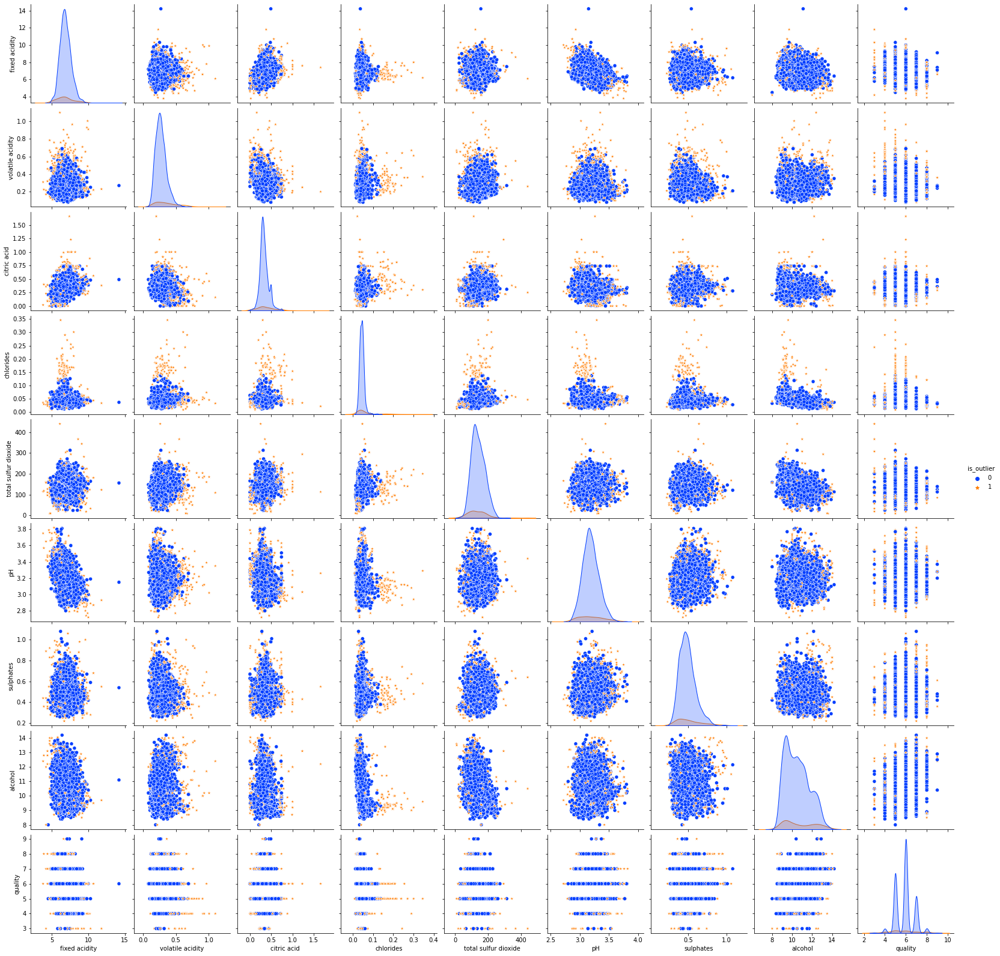

In [125]:
outlier_df_isolation = main_df.copy()
outlier_df_isolation['is_outlier'] = isolation_outliers

sns.pairplot(data=outlier_df_isolation, hue='is_outlier', hue_order=[0, 1], markers=['o', '*'], palette='bright');

In [126]:
show_number_ratio_anomalies(isolation_outliers)

N Anomalies: 490
Anomalies Ratio: 10.0 %


На некторых графиках, мы ложно приняли выбросы за хорошие наблюдения, необходимо увеличить параметр `contamination=0.2`

### Финальное Сравнение Методов 
Мы "прогнали" разные методы и получили немного разные результаты. Методы являются нескоррелированными, так как их предсказания различны. Следовательно, можем прогнать наблюдения через все модели и затем определить долю (сколько процентов моделей) считает данное наблюдение аномальным. 

Далее, отобрать аномалии по порогу. Например, аномалия если ensemble алгоритм считает его аномальным с вероятностью 90%

In [144]:
# Создадим DataFrame с бинарными признаками (1 - объект является аномалией)
summary = np.concatenate((
    [is_outlier_sigma],
    [is_outlier_irq], 
    [euclidean_outliers],
    [dbscan_outliers],
    [svm_outliers],
    [isolation_outliers]
))

columns = ['sigma', 'iqr', 'euclid', 'dbscan', 'svm', 'isolation']
summary_df = pd.DataFrame(summary.T, columns=columns)

summary_df.head()

,sigma,iqr,euclid,dbscan,svm,isolation
0,0,0,0,0,0,0
1,0,0,0,0,0,0
2,0,0,0,0,0,0
3,0,0,0,0,0,0
4,0,0,0,0,0,0


In [151]:
# Число найденных аномалий для конкретного метода 
summary_df.sum(axis='rows')

sigma        381
iqr          199
euclid       489
dbscan       445
svm          493
isolation    490
dtype: int64

In [153]:
summary_df.sum(axis='columns').value_counts()

0    4161
1     163
4     125
6     121
5     118
2     112
3      98
dtype: int64

- Мы обнаружили 4161 наблюдение которое точно не является аномалией (в каждом методе мы имеем 0)
- 163 объекта являются аномальным для одного из методов 
- 125 объектов являются аномальными для 4 методов 

...

- 121 наблюдение является аномальным для всех методов

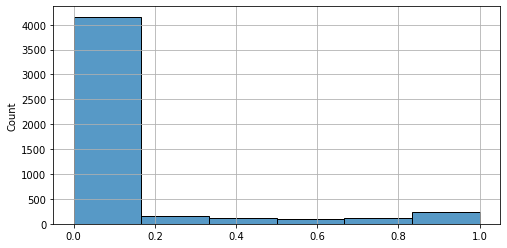

In [179]:
outliers_ratio = summary_df.mean(axis=1)

plt.figure(figsize=(8,4))
sns.histplot(outliers_ratio, bins=6)
plt.grid()

Получаем распределение с тяжёлым правым хвостом. Это неудивительно, ведь лишь в небольшом числе случаев все модели посчитали некоторые наблюдения как аномалии.

Теперь мы можем считать наблюдениее аномальным согласно некоторому парогу. Например, если доля моделей, которые считают наблюдение аномальным, больше некоторого парогового значения - объект 100% аномалия

In [181]:
outliers_score = outliers_ratio.apply(lambda x: 0 if x < 0.4 else 0.5 if x < 0.8 else 1)

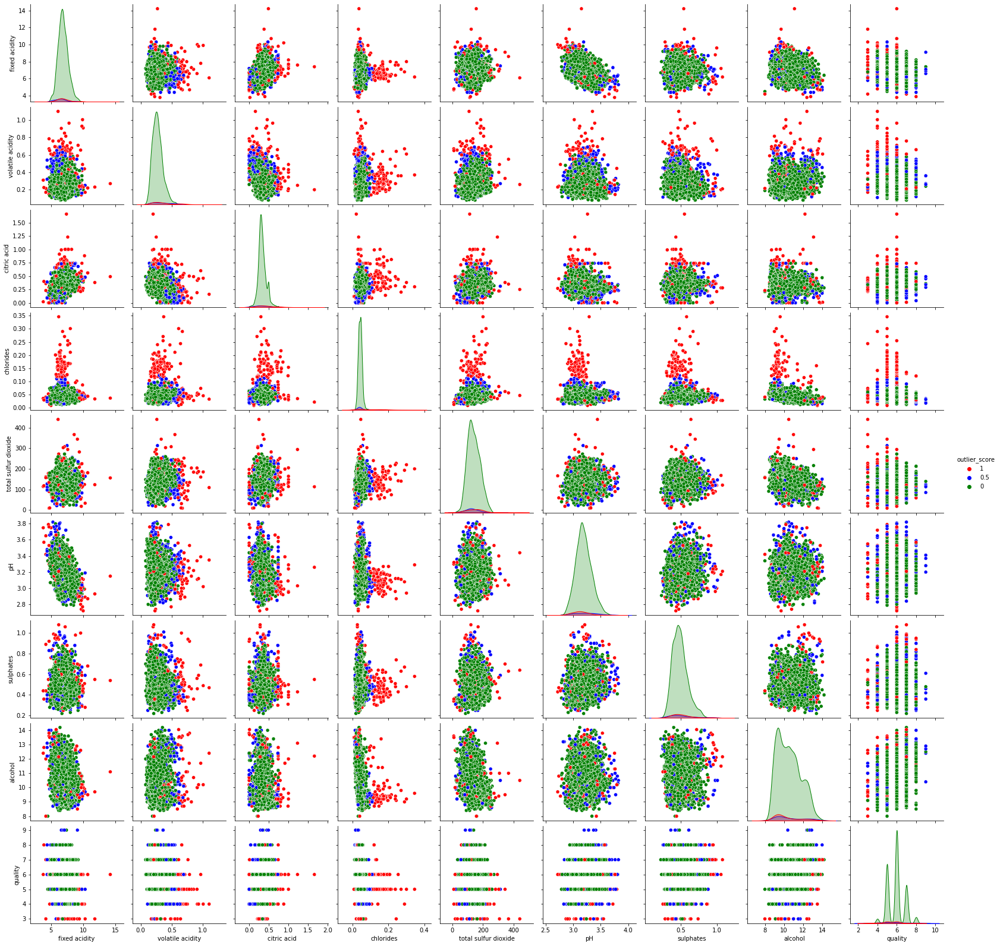

In [183]:
outlier_res = main_df.copy()
outlier_res['outlier_score'] = outliers_score

custom_palette = {0:'g', 0.5:'b', 1.0:'r'}

sns.pairplot(data=outlier_res, hue='outlier_score', hue_order=[1, 0.5, 0], palette=custom_palette);

- Зелёным цветом мы видим наблюдения которые 100% "хорошие" и не являются аномальными. Меньше чем 40 % моделей посчитали их аномальными. Действительно, это плотные облака точек в которых наблюдения очень сильно похожи друг на друга 


- Синим цветом мы видим пограничные значения. Такие наблюдения являются аномальными лишь для половины моделей. Такие точки находятся вокруг плотного кластера "хороших" точек и осуществляют переход в аномалии.


- Красным цветом представлены аномалии. Для таких наблюдений более 80% моделей предсказало их как аномалии. Действительно, данные наблюдения сильно выходят за плотный кластер основных точек

### Only Model-Based
Проведем аналогичное сравнение, но используя только результаты моделей

In [201]:
outliers_count_models = summary_df[['dbscan', 'svm', 'isolation']].sum(axis=1)
outliers_count_models.value_counts()

0    4213
3     266
2     211
1     208
dtype: int64

Число аномальных наблюдений, используя только модели выше. Все три модели считают 266 наблюдения аномальными

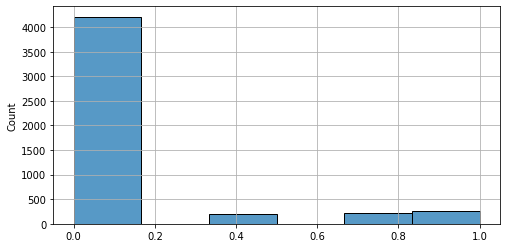

In [202]:
outliers_ratio_models = summary_df[['dbscan', 'svm', 'isolation']].mean(axis=1)

plt.figure(figsize=(8,4))
sns.histplot(outliers_ratio_models, bins=6)
plt.grid()

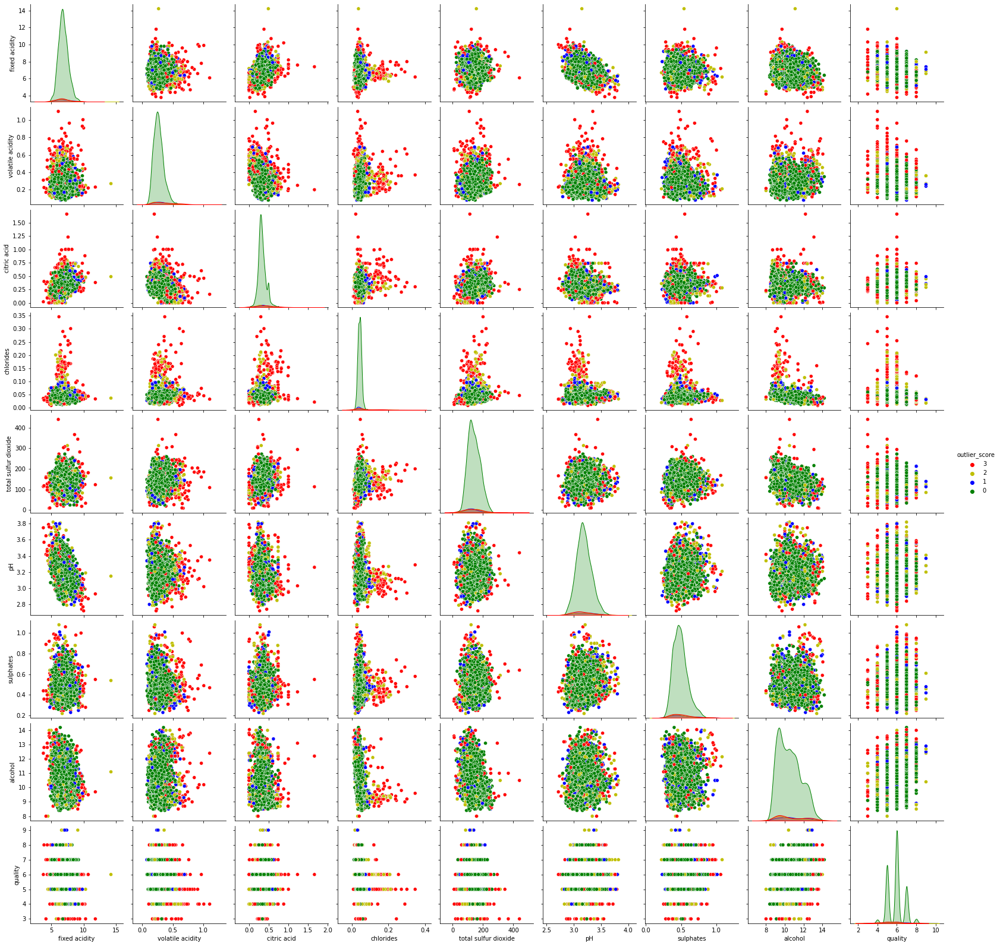

In [206]:
outlier_res_models = main_df.copy()
outlier_res_models['outlier_score'] = outliers_count_models

custom_palette = {0:'g', 1:'b', 2:'y', 3:'r'}

sns.pairplot(data=outlier_res_models, hue='outlier_score', hue_order=[3, 2, 1, 0], palette=custom_palette);

Особенно интересно посмотреть на графики по признаку `chlorides`, чем больше моделей считает наблюдение аномальным, тем сильнее мы захватываем правый хвост распределения 

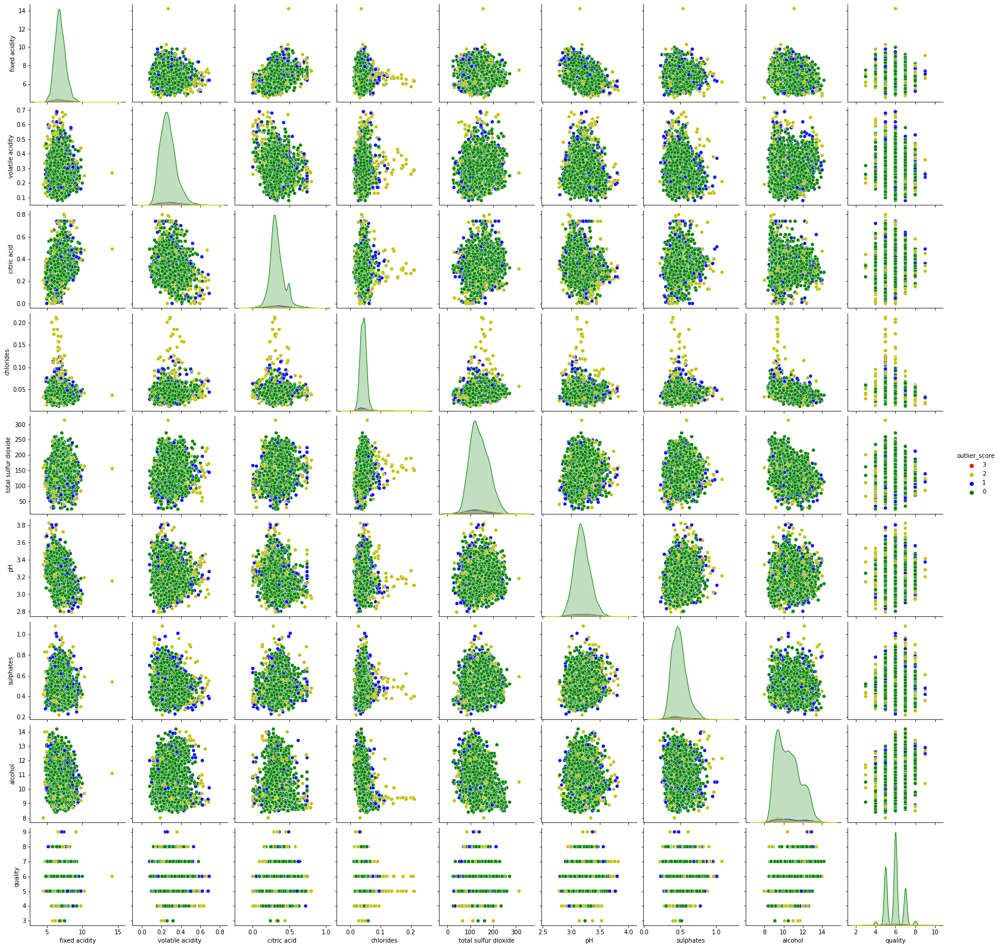

In [208]:
# Рассмотрим без 100% аномалий
sns.pairplot(data=outlier_res_models[outlier_res_models.outlier_score != 3],
             hue='outlier_score',
             hue_order=[3, 2, 1, 0],
             palette=custom_palette
);

Данные выглядят намного лучше, но хлориды по-прежнему страдают от тяжелых правых хвостов

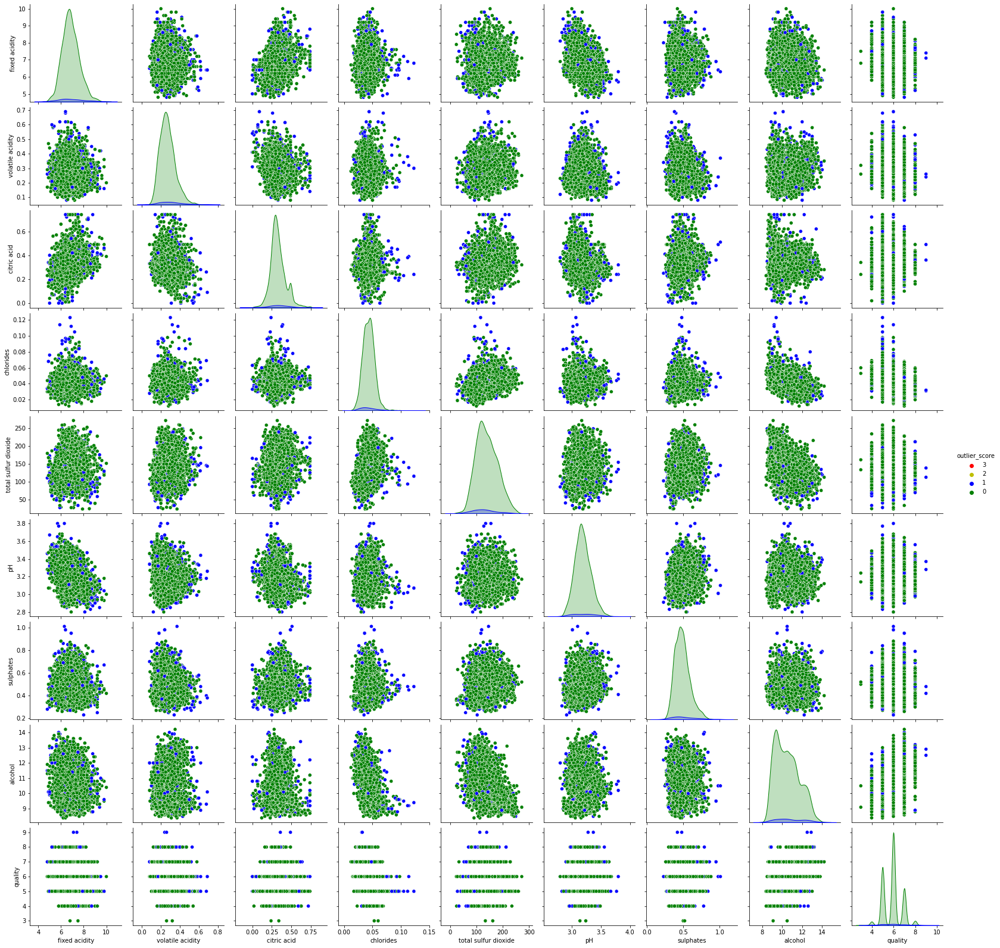

In [209]:
# Только хорошие и пограничные наблюдения 
sns.pairplot(data=outlier_res_models[outlier_res_models.outlier_score.isin([0,1])],
             hue='outlier_score',
             hue_order=[3, 2, 1, 0],
             palette=custom_palette
);

Присутствует лишь небольшая доля выбросов

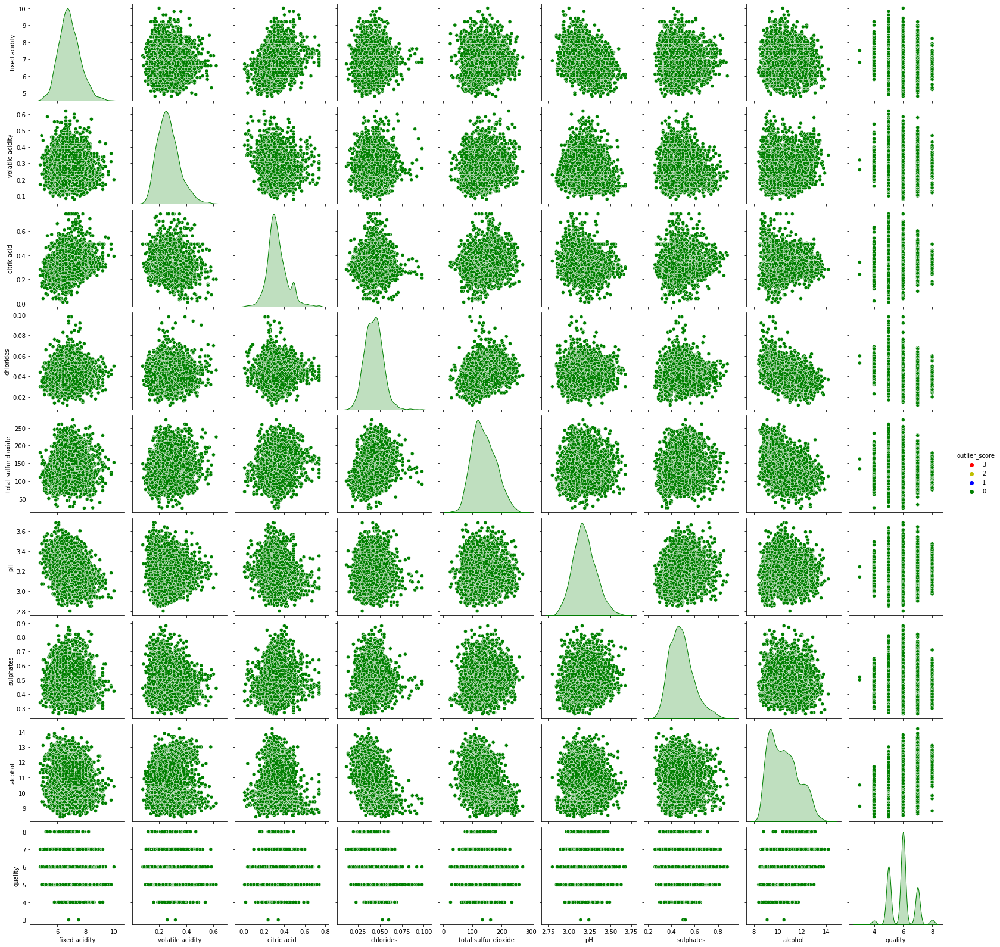

In [211]:
# Только хорошие наблюдения (финальные очищенные данные без аномалий)
sns.pairplot(data=outlier_res_models[outlier_res_models.outlier_score.isin([0])],
             hue='outlier_score',
             hue_order=[3, 2, 1, 0],
             palette=custom_palette
);

На очищенных данных можно уже "гонять" модель и применять различные статистические тесты 



### Дополнительная Информация 
- Аномалии во временных рядах: 
    - https://medium.com/open-machine-learning-course/open-machine-learning-course-topic-9-time-series-analysis-in-python-a270cb05e0b3

- Плотностные методы для поиска аномалий (не только DBSCAN): 
    - https://towardsdatascience.com/density-based-algorithm-for-outlier-detection-8f278d2f7983

- Верхнеуровневая библиотека `PyOD` с кучей методов для поиска аномалий: 
    - https://www.analyticsvidhya.com/blog/2019/02/outlier-detection-python-pyod/
    
- https://blog.floydhub.com/introduction-to-anomaly-detection-in-python/

### Источник Данного Ноутбука
- https://www.youtube.com/watch?v=NWOSVklohlI&t=1877s

### Некоторые Вопросы:
- Какую долю аномалий можно оставить при обучении - (нужно тестировать, однозначного ответа нет)
- Очистка аномалий проводиться только на train - (да, иначе мы вносим информацию из test в обучение)
- 